In [1]:
%pylab inline
from matplotlib.colors import LogNorm

Populating the interactive namespace from numpy and matplotlib


In [2]:
cd ~/project/FLASH4.3_3/object/

/global/project/projectdirs/astro250/doris/FLASH4.3_3/object


In [3]:
import yt
from yt.units import second, g, cm ,dyne
G = 6.674e-8*cm**3/second**2/g
ctr = 5e18*cm

In [4]:
def _r(field,data):
    r = sqrt((data["x"]-ctr)**2+(data["y"]-ctr)**2+(data["z"]-ctr)**2)
    return r
def _v_mag(field,data):
    return sqrt(data['velocity_x']**2+data['velocity_y']**2+data['velocity_z']**2)
def _omega(field,data):
    return sqrt(data['velocity_x']**2+data['velocity_y']**2+data['velocity_z']**2)/(data["r"]+(1.e-18*cm))
yt.add_field("r",function= _r,units="cm")
yt.add_field("v_mag",function= _v_mag,units="cm/s")
yt.add_field("omega",function= _omega,units="1/s")

from yt.mods import *
yt.funcs.mylog.setLevel(50) #coerce output null

def compute_current_time(timestep):
    ds = yt.load("sod_hdf5_chk_{}".format(str(timestep).zfill(4)))
    return  ds.current_time
def plot_dens(i,velocity=False,grid=False,zmin ="",zmax="",particle=False):
    ds = yt.load("sod_hdf5_chk_{}".format(str(i).zfill(4)))
    physical_quantity="density"
    slc = yt.SlicePlot(ds, "z",physical_quantity)#,center=(0.5,0.5,0.5))
    slc.set_figure_size(5)
    if grid: slc.annotate_grids()
    if velocity: slc.annotate_velocity()
    slc.set_cmap("all","rainbow")
    if zmin!="" and zmax!="": slc.set_zlim(physical_quantity,zmin,zmax)
    if particle : 
        data =np.loadtxt("sinks_evol.dat_cleaned",skiprows=1)
        pcl_indx_at_t = np.where(np.isclose(int(ds.current_time.in_cgs()),data[:,1]))[0]
        print "Number of sink particles: " , len(pcl_indx_at_t)
        pcl_pos_at_t = data[pcl_indx_at_t,2:5]
        for pos in pcl_pos_at_t:
            slc.annotate_marker(pos, coord_system='data',marker='.',plot_args={'color':'black','s':3})
    slc.show()

def plot_vmag(i,velocity=False,grid=False,zmin ="",zmax="",particle=False):
    ds = yt.load("sod_hdf5_chk_{}".format(str(i).zfill(4)))
    physical_quantity="v_mag"
    slc = yt.SlicePlot(ds, "z",physical_quantity)#,center=(0.5,0.5,0.5))
    slc.set_figure_size(5)
    if grid: slc.annotate_grids()
    if velocity: slc.annotate_velocity()
    slc.set_cmap("all","rainbow")
    if zmin!="" and zmax!="": slc.set_zlim(physical_quantity,zmin,zmax)
    slc.show()

def plot_omega(i,velocity=False,grid=False,zmin ="",zmax="",particle=False):
    ds = yt.load("sod_hdf5_chk_{}".format(str(i).zfill(4)))
    physical_quantity="omega"
    slc = yt.SlicePlot(ds, "z",physical_quantity)#,center=(0.5,0.5,0.5))
    slc.set_figure_size(5)
    if grid: slc.annotate_grids()
    if velocity: slc.annotate_velocity()
    slc.set_cmap("all","rainbow")
    if zmin!="" and zmax!="": slc.set_zlim(physical_quantity,zmin,zmax)
    slc.show()

def compute_omega(beta):
    M =  4.53382324263e+36
    G= 6.67e-8
    rmax = 16.9
    return sqrt(3*G*M*beta/(rmax/1.057e-17)**3)

### See if sink can help make the $\beta$ = 0.01 case more long lived and see if we could get a disk forming

In [15]:
cd ../beta_0.01sink/

/global/project/projectdirs/astro250/doris/FLASH4.3_3/beta_0.01sink


This is actually __WORSE__ than the no sink case which ran until  1.05355443e+12 at timestep 53

In [17]:
compute_current_time(48)

9.5355443e+11 code_time

0.0 code_time



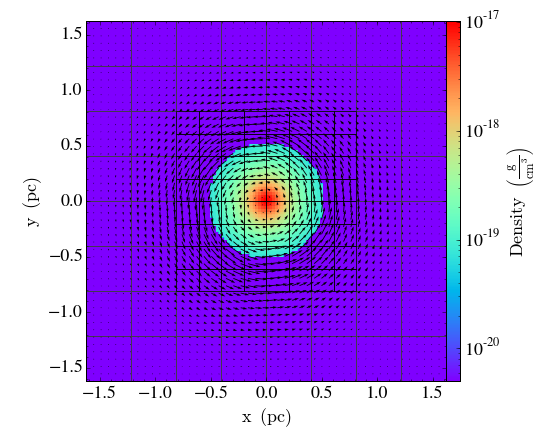

93554430000.0 code_time



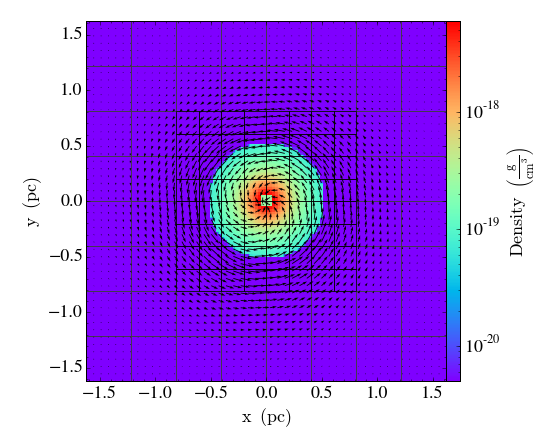

1.9355443e+11 code_time



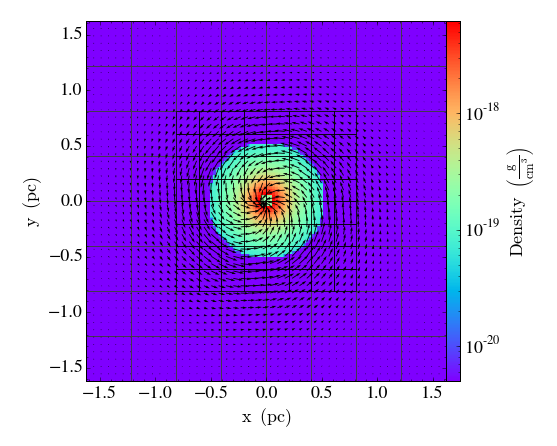

2.9355443e+11 code_time



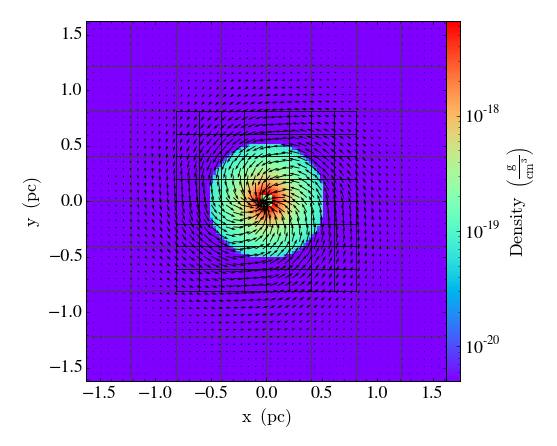

3.9355443e+11 code_time



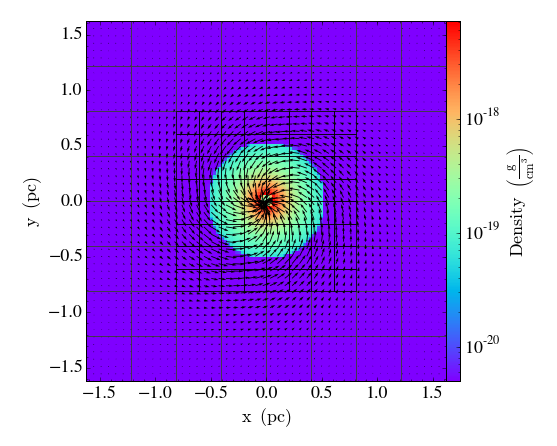

4.9355443e+11 code_time



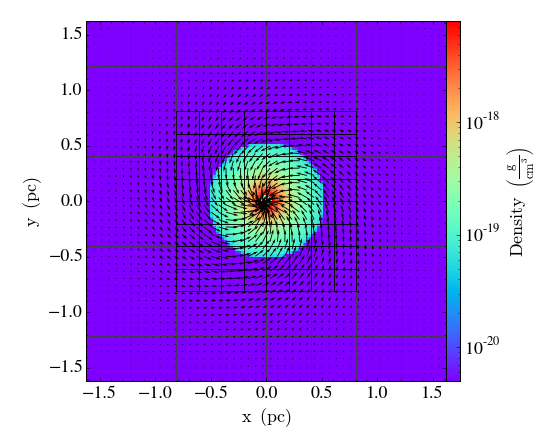

5.9355443e+11 code_time



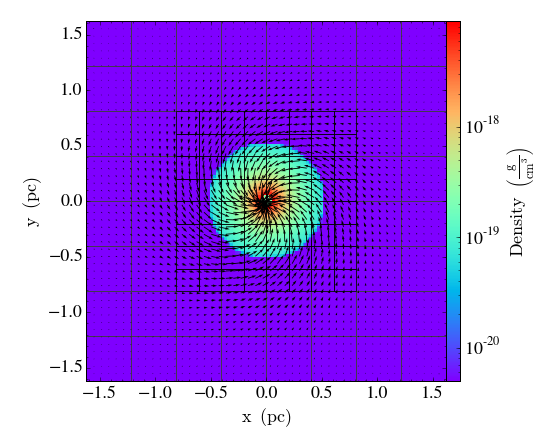

6.9355443e+11 code_time



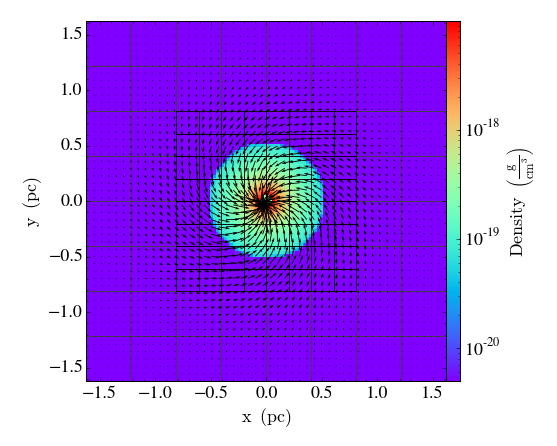

7.9355443e+11 code_time



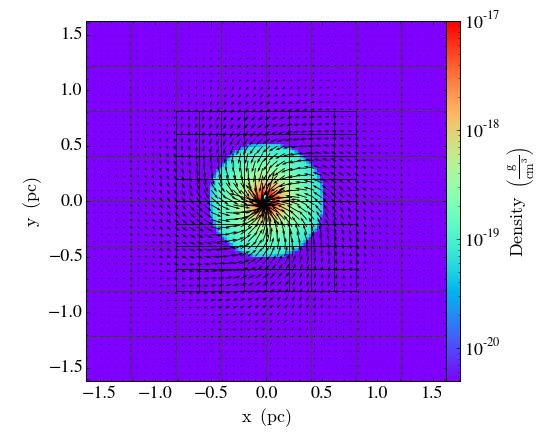

8.9355443e+11 code_time



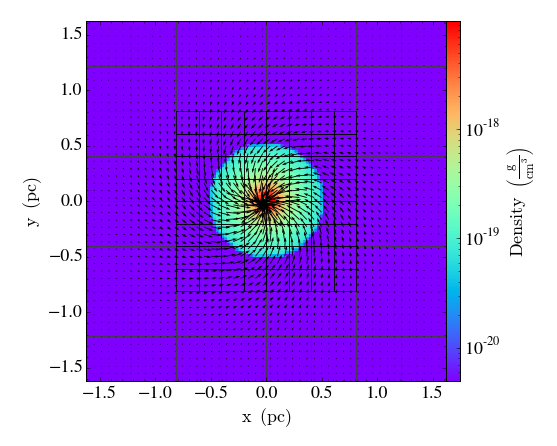

In [19]:
for i in np.arange(48):
    if i%5 ==0:
        print compute_current_time(i)
#         plot_vmag(i,zmin=1e4,zmax=1e6)
#         plot_omega(i,zmin=1e-15,zmax=1e-14)
        plot_dens(i,velocity=True, grid=True)

In [24]:
def all_direction_slices(timestep):
    from mpl_toolkits.axes_grid1 import AxesGrid
    ds = yt.load("sod_hdf5_chk_{}".format(str(timestep).zfill(4)))
    fig = plt.figure()
    grid = AxesGrid(fig, ( (0.1, 0.1, 2, 2)),
                    nrows_ncols = (1, 3),
                    axes_pad = 1.0,
                    label_mode = "1",
                    share_all = True,
                    cbar_location="right",
                    cbar_mode="each",
                    cbar_size="3%",
                    cbar_pad="0%")
    direction = ['x','y','z']
    physical_quantity='density'
#     slc.annotate_text((0.05, 0.02),"time: ".format(ds.current_time), coord_system='axis')
#     print "Time : ", ds.current_time
    for i, direc in enumerate(direction):
        slc = yt.SlicePlot(ds,direc, physical_quantity)
#         slc.set_log(physical_quantity, False)
        slc.set_axes_unit('pc')
        slc.annotate_velocity()
        slc.set_font_size(12)
        plot = slc.plots[physical_quantity]
        plot.figure = fig
        slc.set_cmap(physical_quantity,"rainbow")
        plot.axes = grid[i].axes
        plot.cax = grid.cbar_axes[i]
        slc._setup_plots()

0.0 code_time
93554430000.0 code_time
1.9355443e+11 code_time
2.9355443e+11 code_time
3.9355443e+11 code_time
4.9355443e+11 code_time
5.9355443e+11 code_time
6.9355443e+11 code_time
7.9355443e+11 code_time
8.9355443e+11 code_time


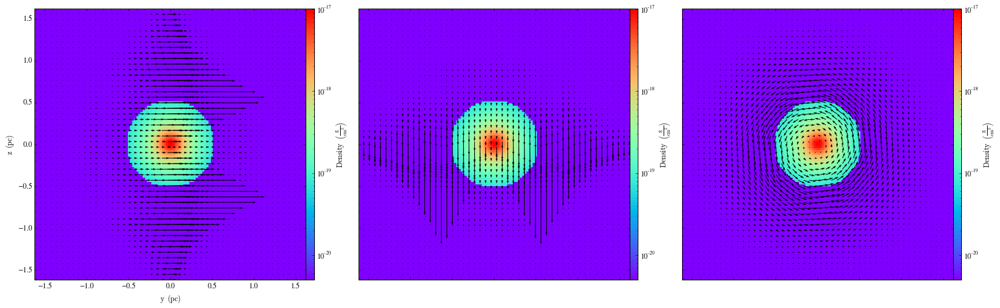

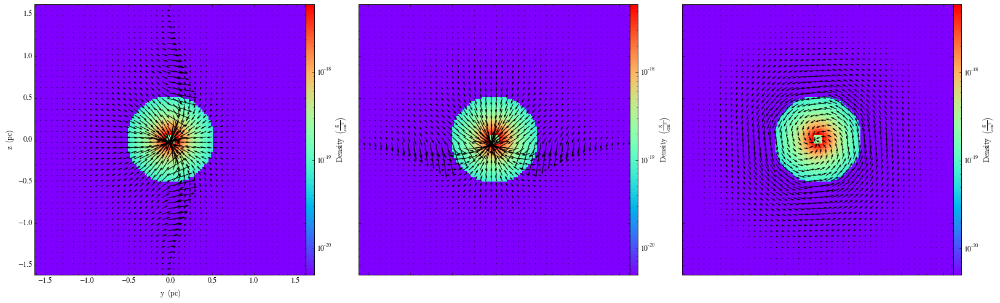

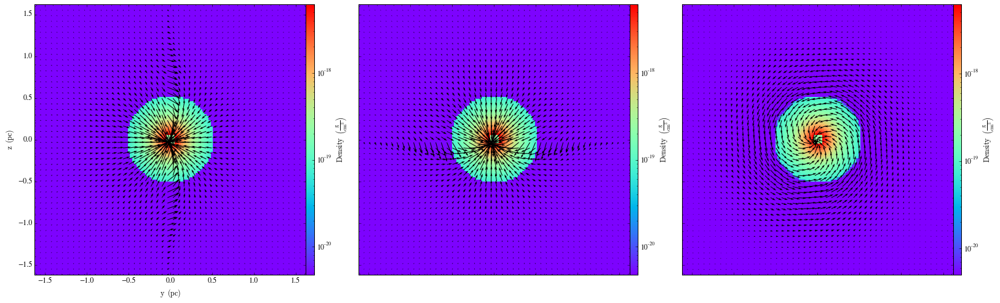

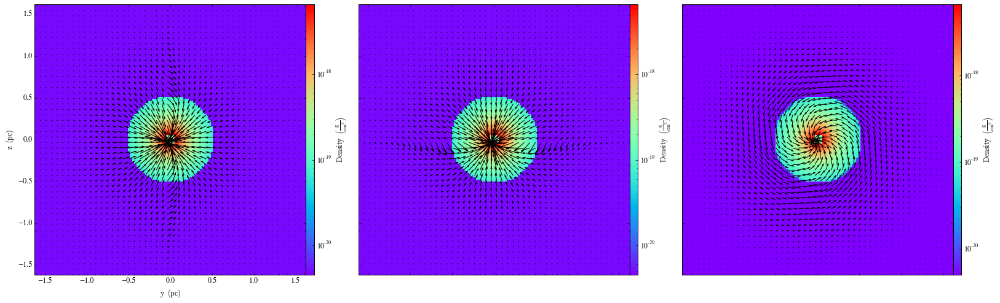

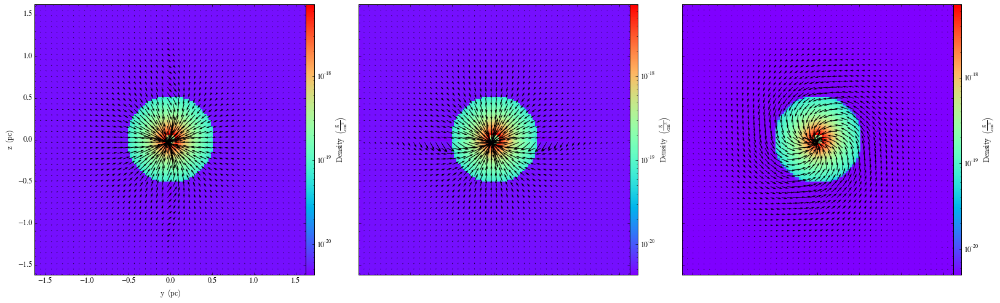

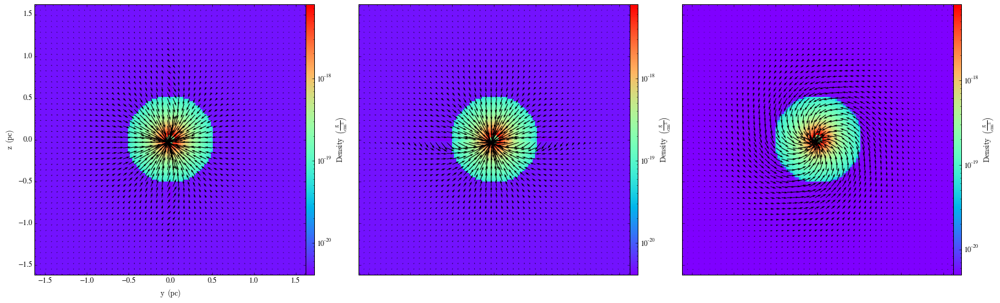

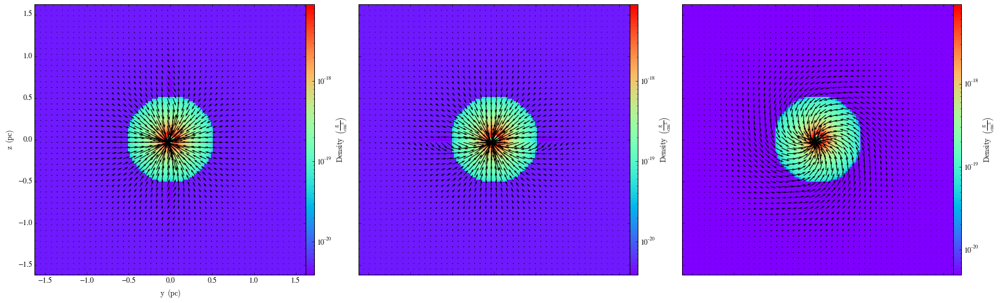

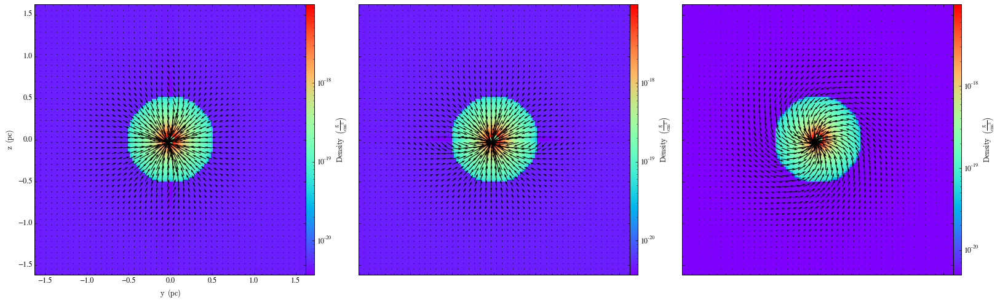

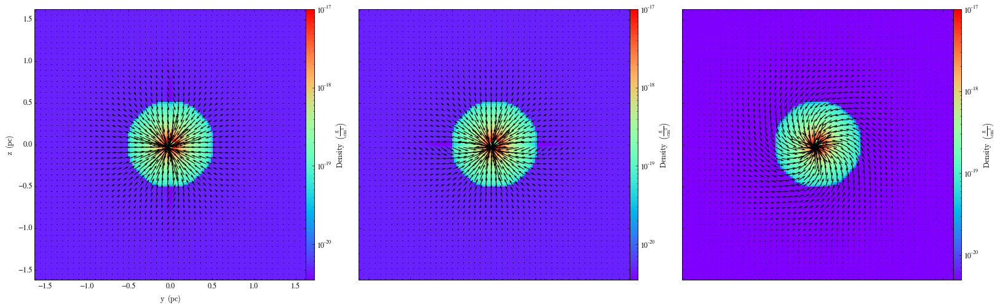

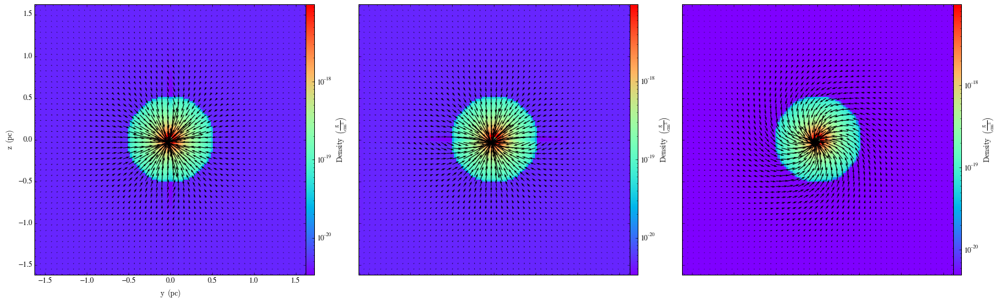

In [25]:
for i in np.arange(48):
    if i%5 ==0:
#         print compute_current_time(i)
        all_direction_slices(i)

### Lowered the CFL from 0.5 to 0.3 

In [26]:
cd ../beta_0.01sink_CFL0.3/

/global/project/projectdirs/astro250/doris/FLASH4.3_3/beta_0.01sink_CFL0.3


In [27]:
compute_current_time(43)

8.5355443e+11 code_time

Also ended at tstep 43 , but actually an earlier time because the steps are smaller

# Fiddling with various sink parameters 

### Refinement based Jean's criterion rather than density based refinement '

In [28]:
cd ../beta_0.01sink_CFL0.3_Jeans

/global/project/projectdirs/astro250/doris/FLASH4.3_3/beta_0.01sink_CFL0.3_Jeans


0.0 code_time



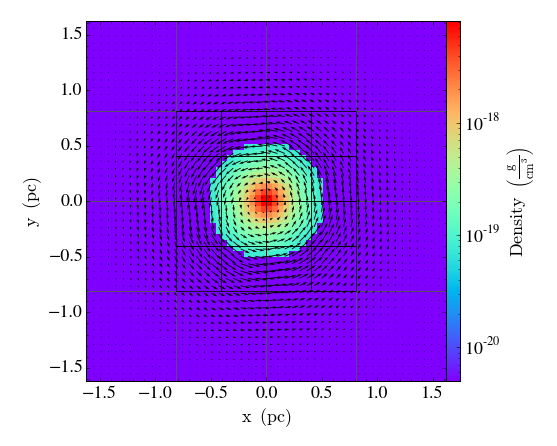

93554430000.0 code_time



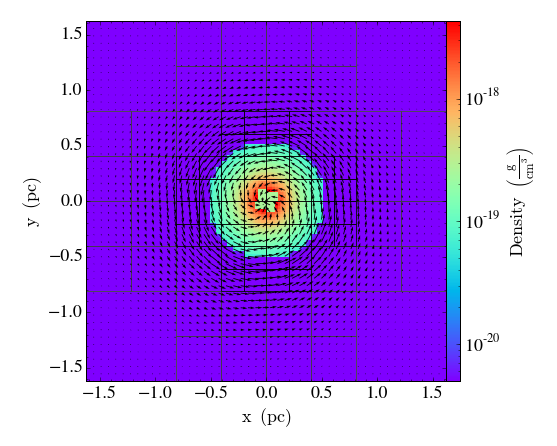

1.9355443e+11 code_time



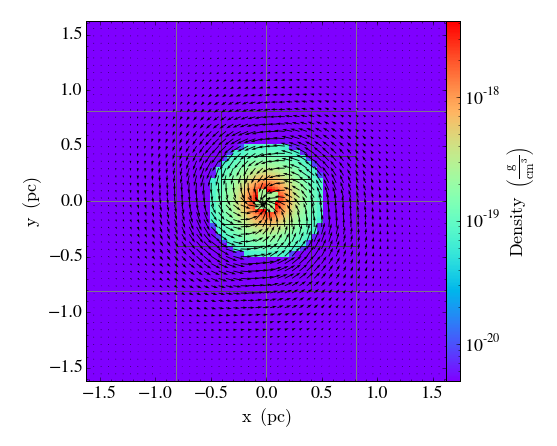

2.9355443e+11 code_time



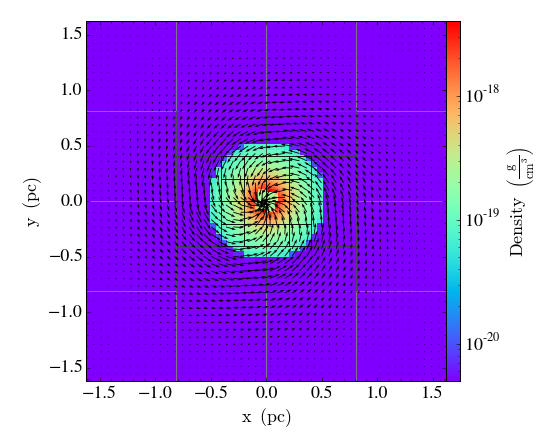

3.9355443e+11 code_time



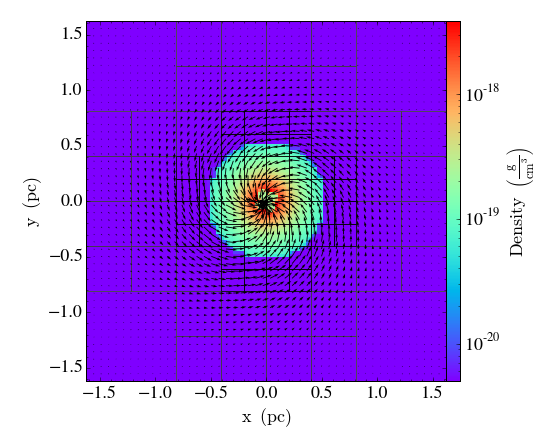

4.9355443e+11 code_time



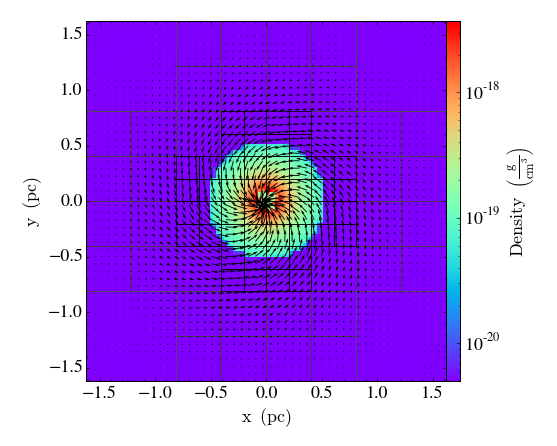

5.9355443e+11 code_time



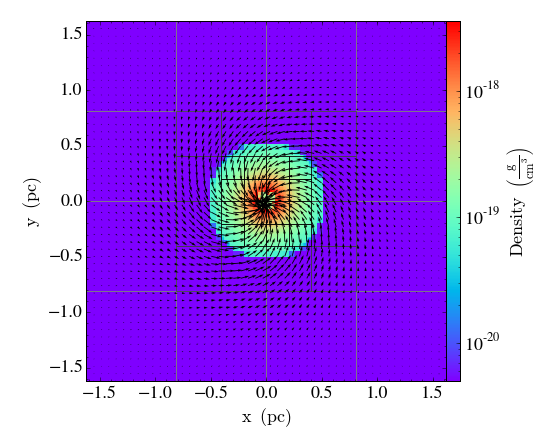

6.9355443e+11 code_time



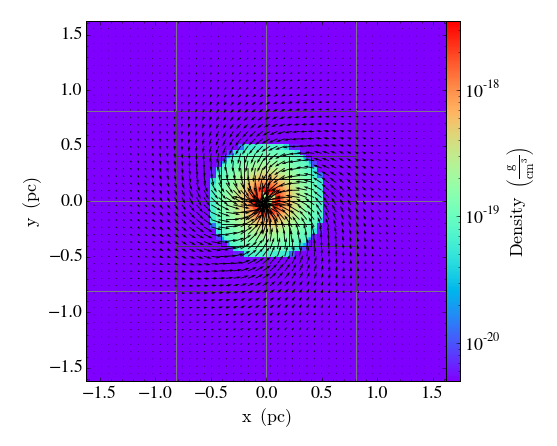

7.9355443e+11 code_time



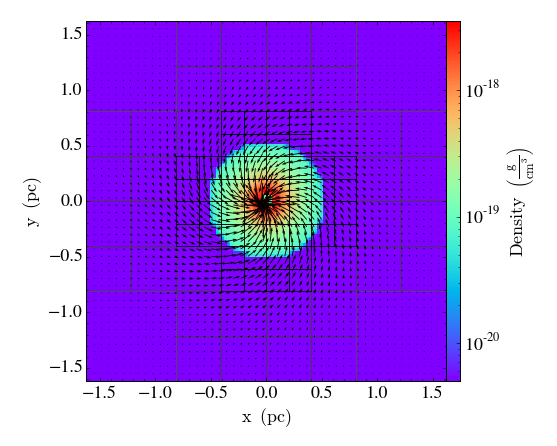

8.9355443e+11 code_time



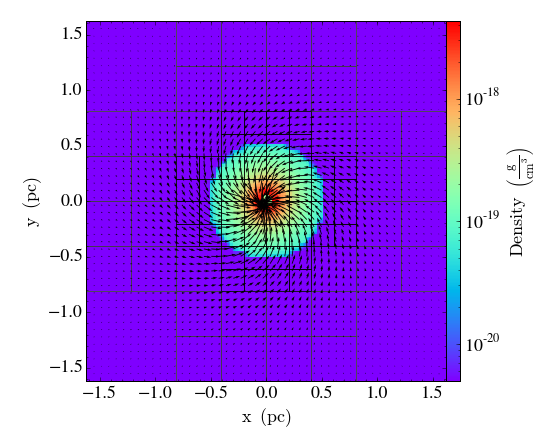

In [29]:
for i in np.arange(49):
    if i%5 ==0:
        print compute_current_time(i)
        plot_dens(i,velocity=True, grid=True)

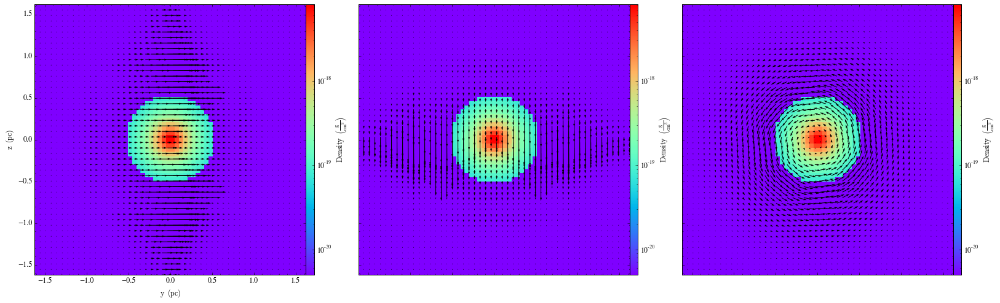

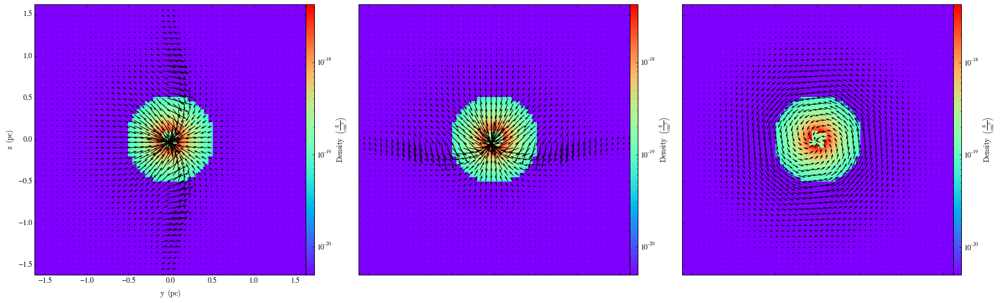

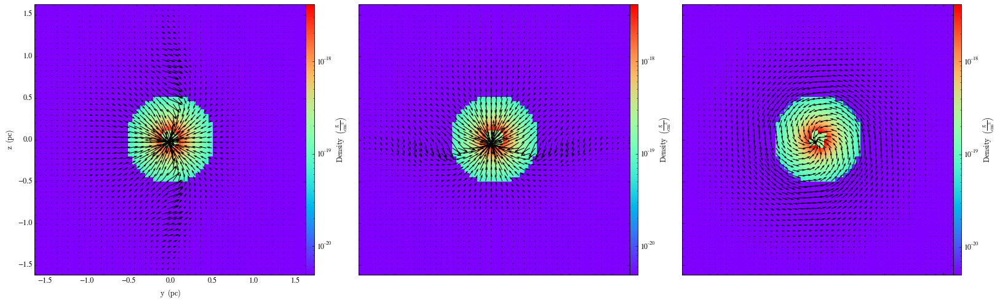

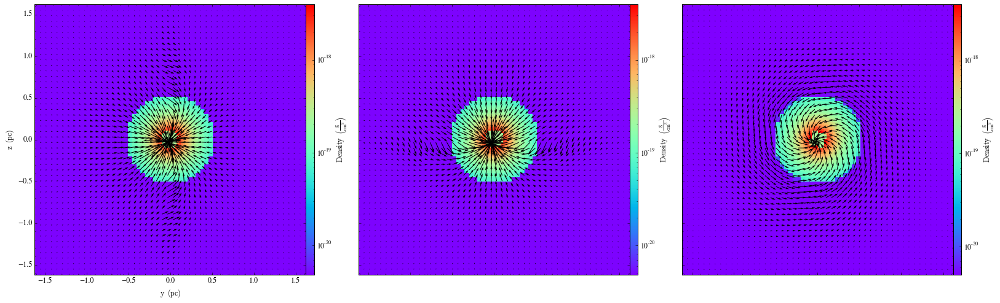

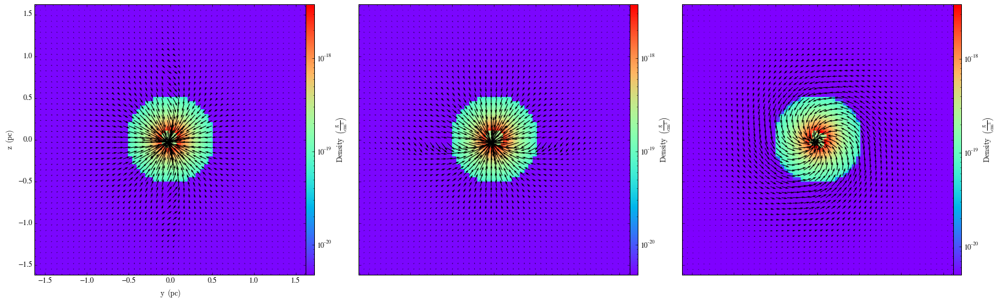

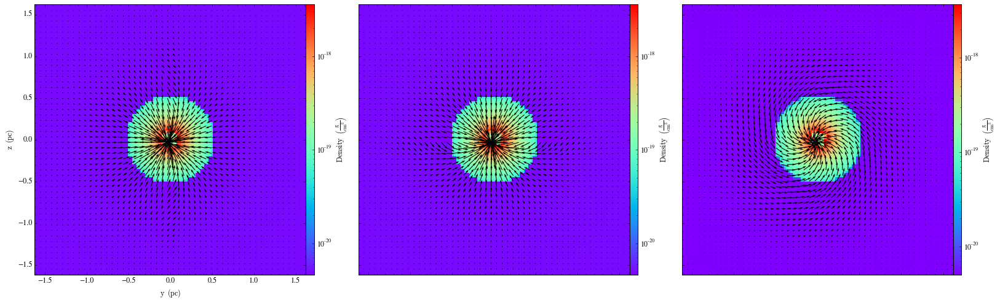

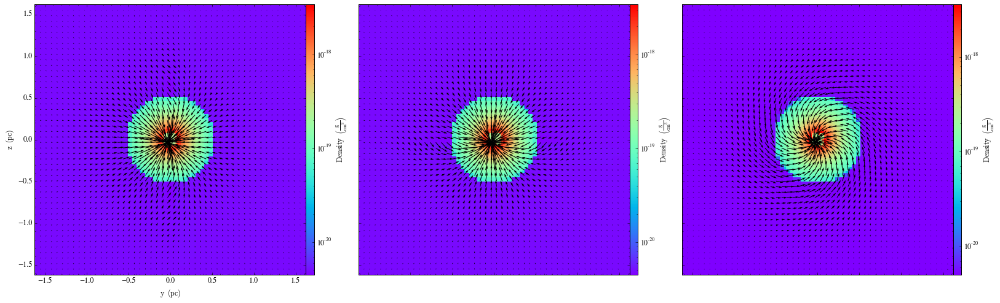

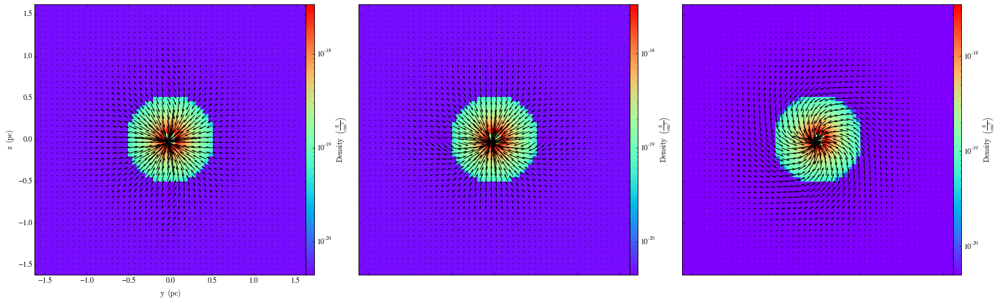

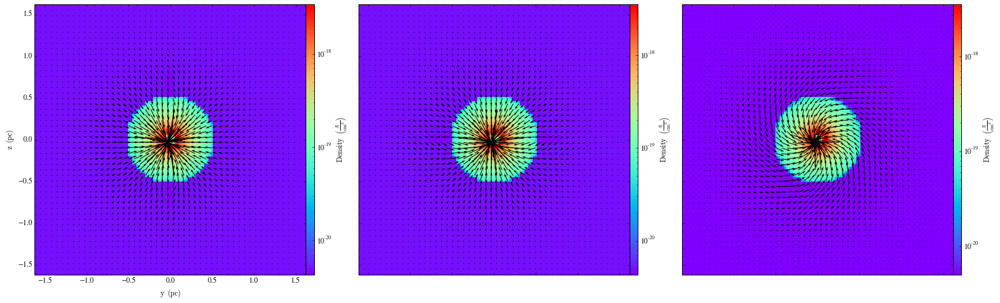

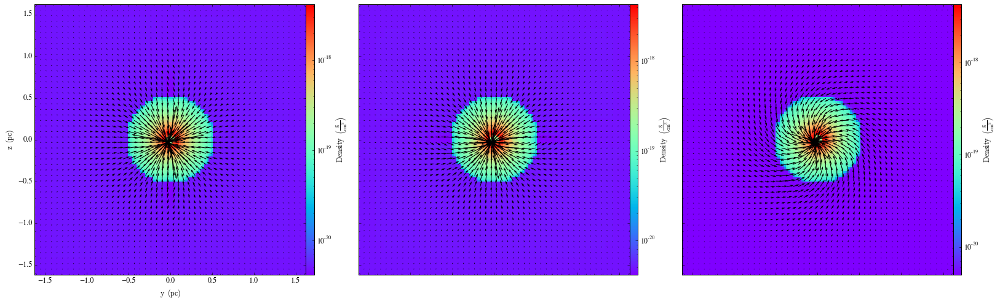

In [30]:
for i in np.arange(49):
    if i%5 ==0:
        all_direction_slices(i)

In [31]:
compute_current_time(49)

9.7355443e+11 code_time

##### so that actually helped with elongating the time for a bit 2e10 s extra time compared to the regular sink case (CFL = 0.5 and density-based AMR)

## Increase the AMR resolution  from lev 3~5 to 5~7

In [49]:
cd ../hi_res_beta_0.01sink_CFL0.3_Jeans/

/global/project/projectdirs/astro250/doris/FLASH4.3_3/hi_res_beta_0.01sink_CFL0.3_Jeans



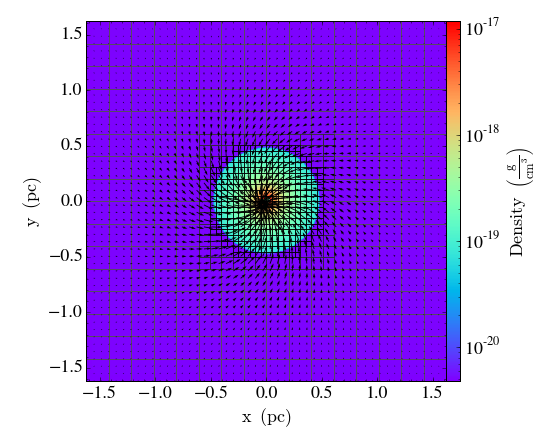

In [44]:
plot_dens(100,velocity=True,grid=True)


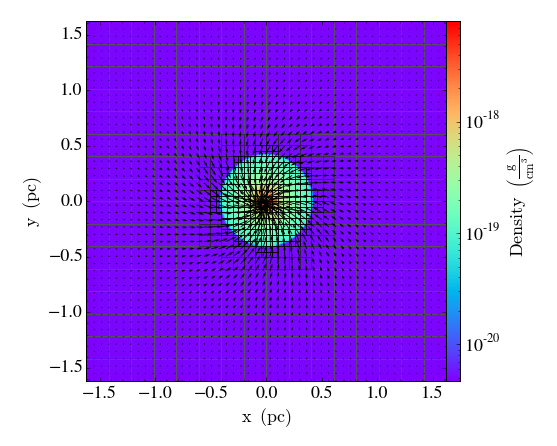

In [45]:
plot_dens(177,velocity=True,grid=True)

In [42]:
compute_current_time(179)

2.34207279735e+12 code_time


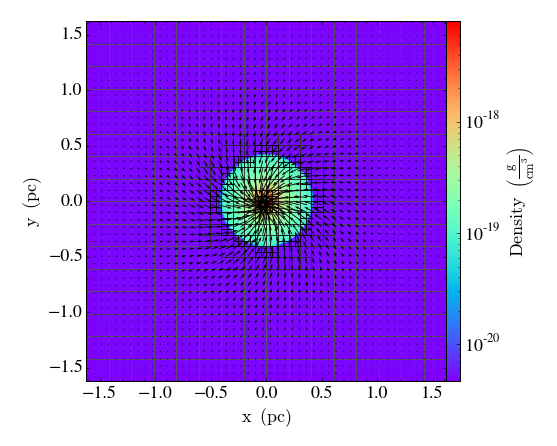

In [46]:
plot_dens(179,velocity=True,grid=True)

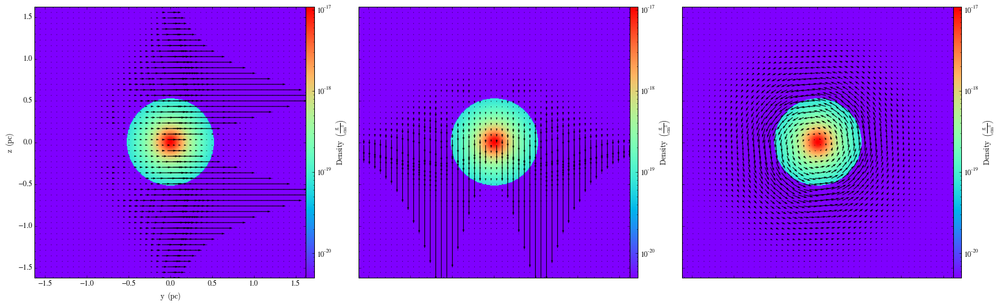

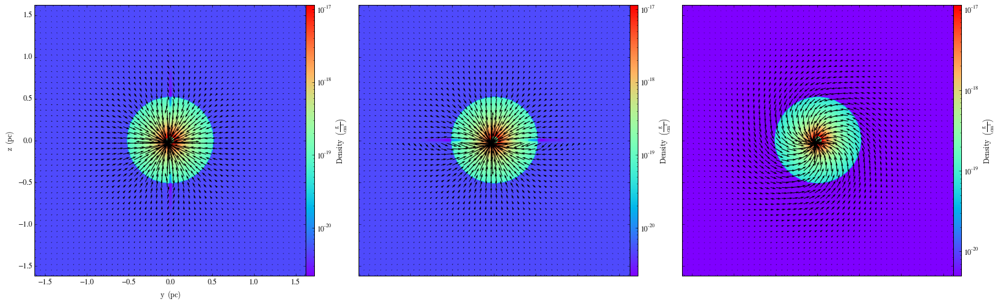

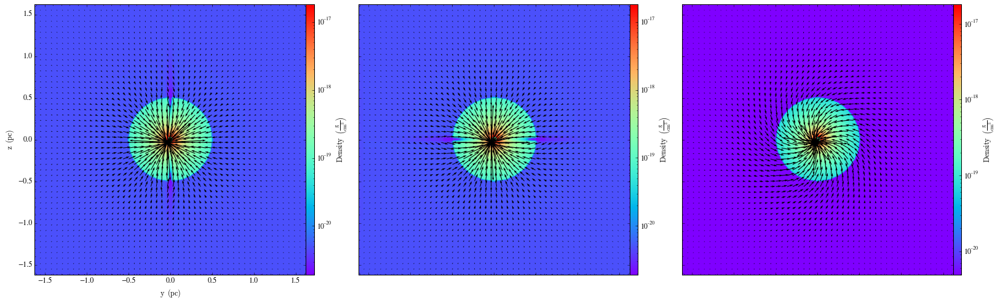

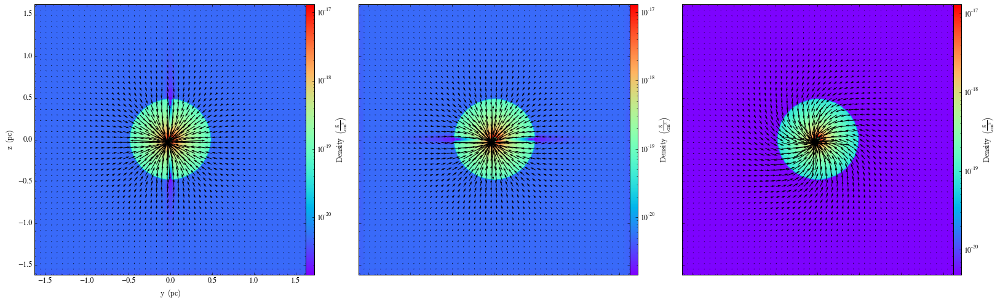

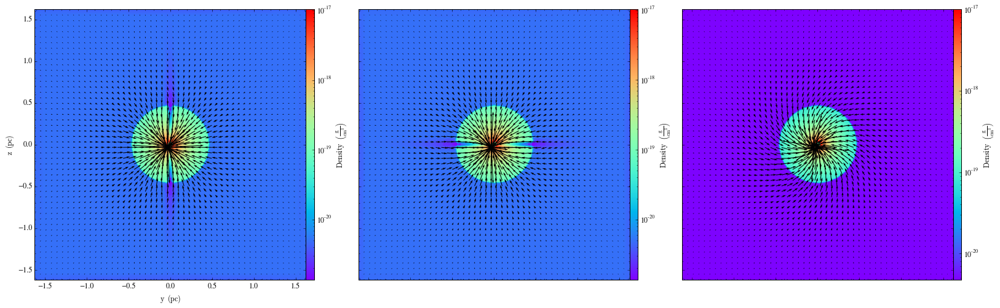

...

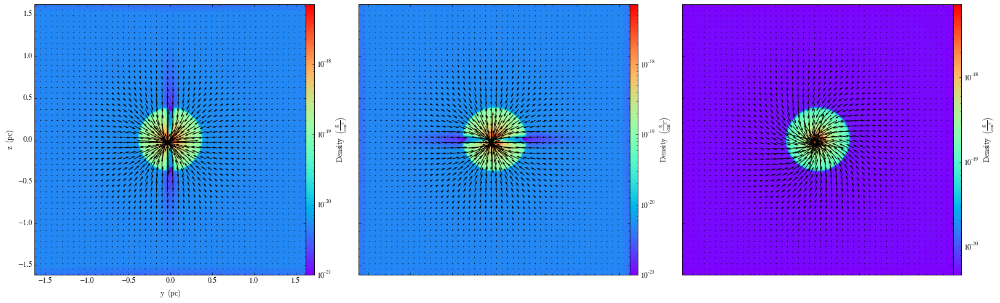

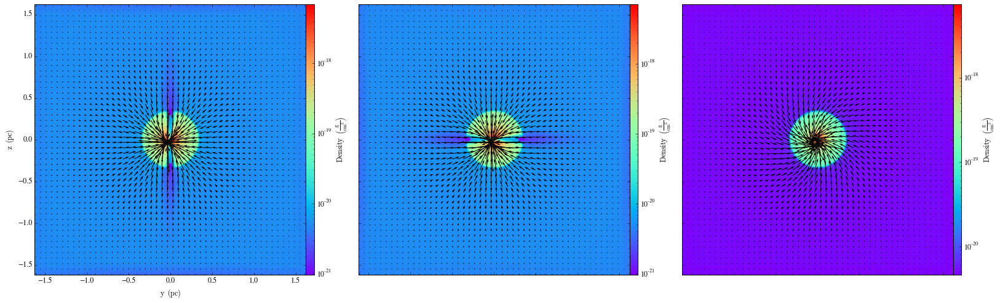

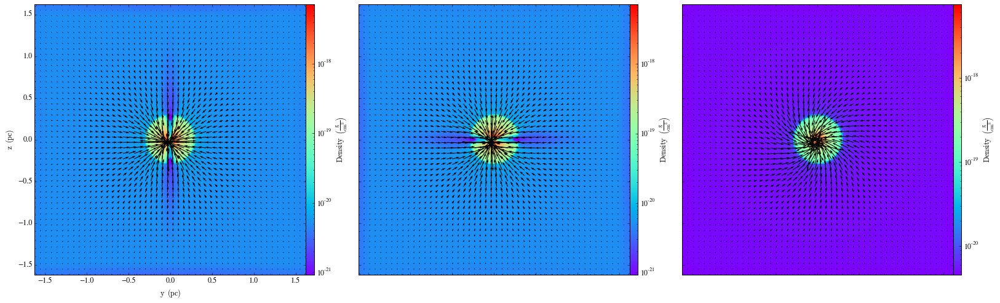

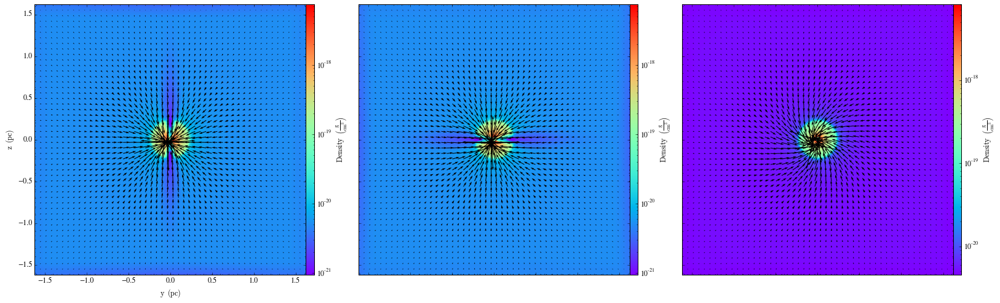

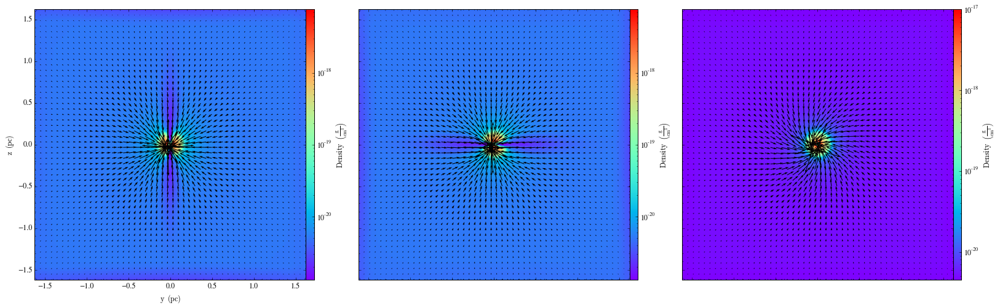

In [50]:
END_TIME = 348
for i in np.arange(END_TIME):
    if i%30 ==0:
        all_direction_slices(i)


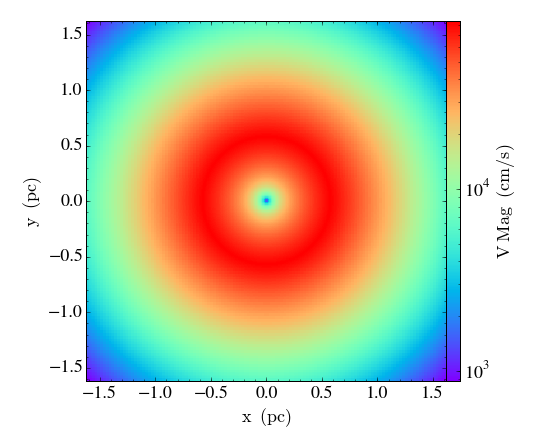


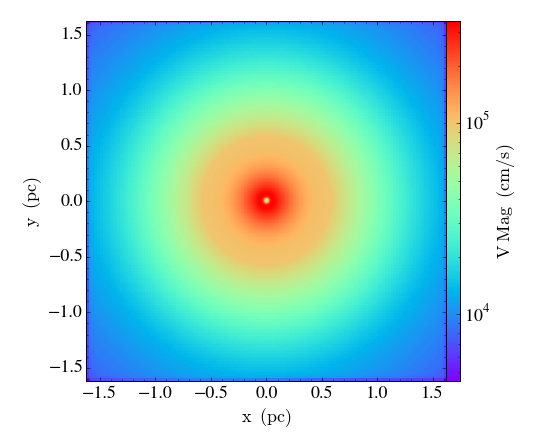


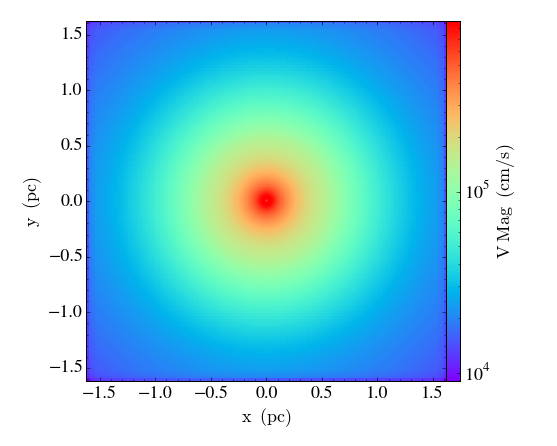


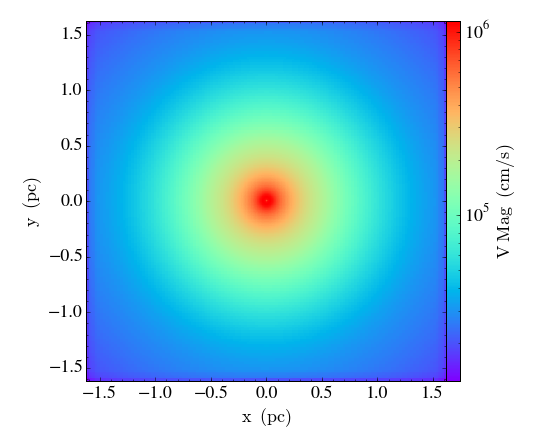


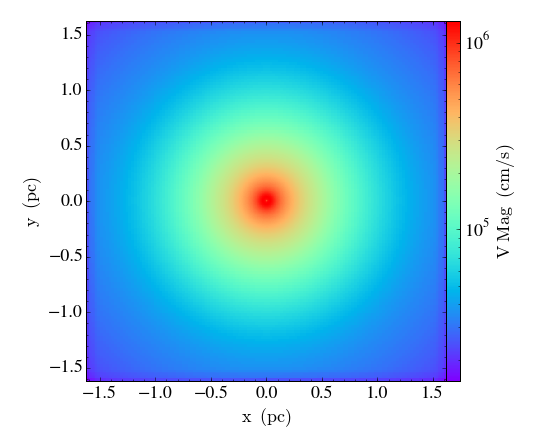


...


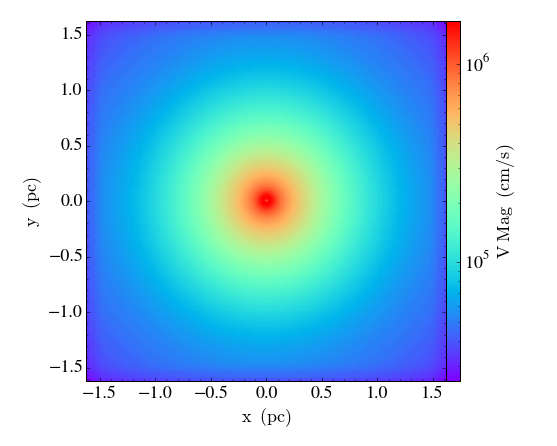


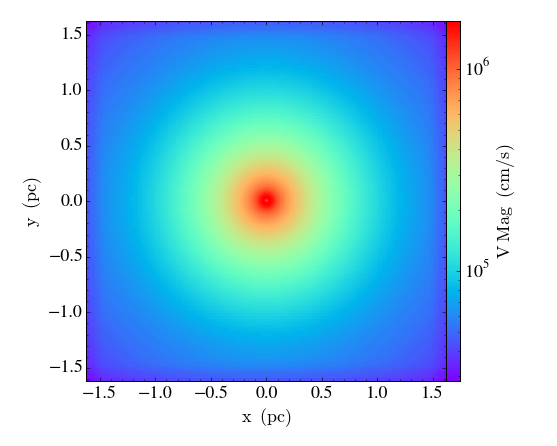


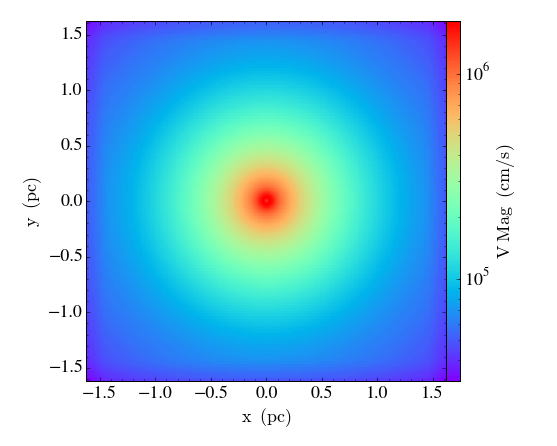


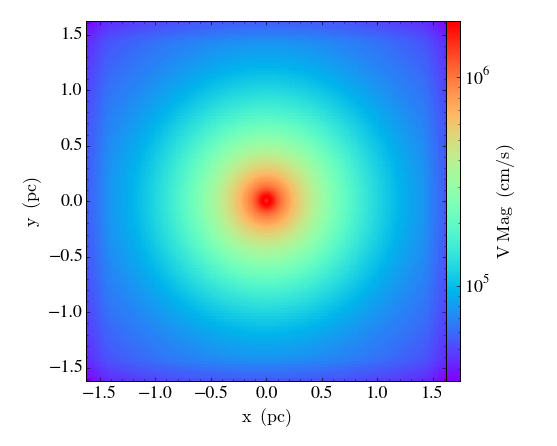


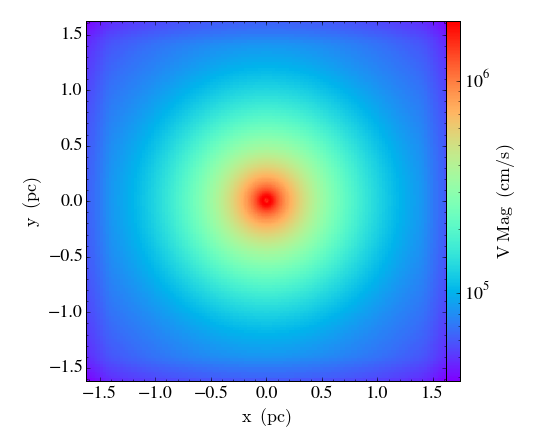

In [53]:
END_TIME = 348
for i in np.arange(END_TIME):
    if i%30 ==0:
        plot_vmag(i)


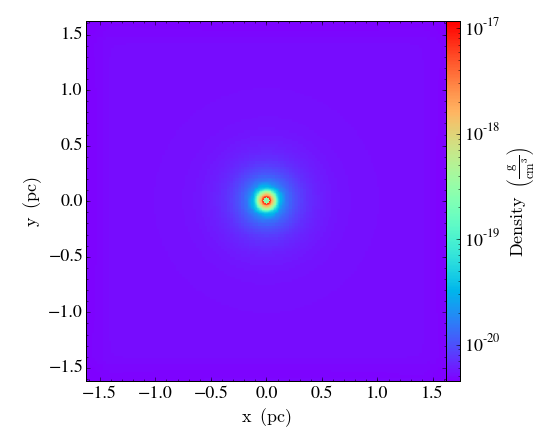

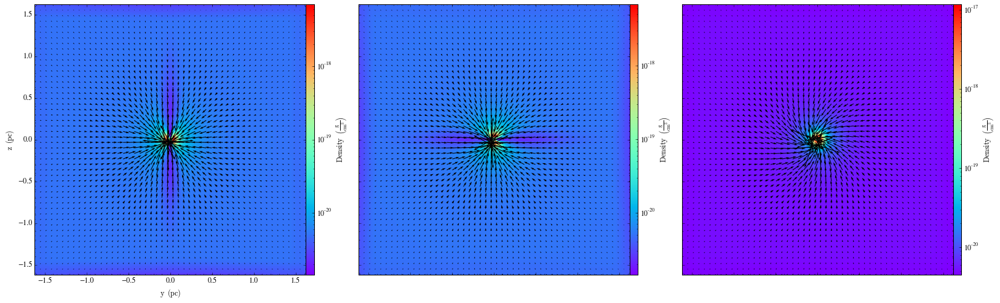

In [52]:
plot_dens(END_TIME)
all_direction_slices(END_TIME)

In [54]:
print compute_current_time(END_TIME)

4.03242781815e+12 code_time
